In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
!pip install matplotlib-venn missingno shap lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 10.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=33c01d9d0a2373337ceddb972829a0715b330fd4c23093fd67a725ef803b98c6
  Stored in directory: /root/.cache/pip/wheels/e7/5d/0e/4b4fff9a47468fed5633211fb3b76d1db43fe806a17fb7486a
Successfully built lime


In [3]:
df = pd.read_csv("cleaned_merged_seasons.csv")

/tmp/ipython-input-2862504686.py:1: DtypeWarning: Columns (3) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv("cleaned_merged_seasons.csv")


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 96169 entries, 0 to 96168
Data columns (total 37 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   season_x           96169 non-null  object 
 1   name               96169 non-null  object 
 2   position           96169 non-null  object 
 3   team_x             76317 non-null  object 
 4   assists            96169 non-null  int64  
 5   bonus              96169 non-null  int64  
 6   bps                96169 non-null  int64  
 7   clean_sheets       96169 non-null  int64  
 8   creativity         96169 non-null  float64
 9   element            96169 non-null  int64  
 10  fixture            96169 non-null  int64  
 11  goals_conceded     96169 non-null  int64  
 12  goals_scored       96169 non-null  int64  
 13  ict_index          96169 non-null  float64
 14  influence          96169 non-null  float64
 15  kickoff_time       96169 non-null  object 
 16  minutes            961

In [5]:
pd.set_option('display.max_columns', None)
df.tail()

,season_x,name,position,team_x,assists,bonus,bps,clean_sheets,creativity,element,fixture,goals_conceded,goals_scored,ict_index,influence,kickoff_time,minutes,opponent_team,opp_team_name,own_goals,penalties_missed,penalties_saved,red_cards,round,saves,selected,team_a_score,team_h_score,threat,total_points,transfers_balance,transfers_in,transfers_out,value,was_home,yellow_cards,GW
96164,2022-23,Oliver Skipp,MID,Spurs,0,0,16,0,0.0,441,377,1,0,0.0,0.0,2023-05-28T15:30:00Z,90,11,Leeds,0,0,0,0,38,0,16761,4.0,1.0,0.0,2,100,742,642,43,False,0,38
96165,2022-23,Ryan Sessegnon,DEF,Spurs,0,0,0,0,0.0,436,377,0,0,0.0,0.0,2023-05-28T15:30:00Z,0,11,Leeds,0,0,0,0,38,0,58774,4.0,1.0,0.0,0,-166,24,190,44,False,0,38
96166,2022-23,Ashley Young,DEF,Aston Villa,0,0,0,0,0.0,538,372,0,0,0.0,0.0,2023-05-28T15:30:00Z,0,5,Brighton,0,0,0,0,38,0,96712,1.0,2.0,0.0,0,-1146,1522,2668,43,True,0,38
96167,2022-23,Jeremy Sarmiento Morante,MID,Brighton,0,0,0,0,0.0,119,372,0,0,0.0,0.0,2023-05-28T15:30:00Z,0,2,Aston Villa,0,0,0,0,38,0,4511,1.0,2.0,0.0,0,-17,22,39,45,False,0,38
96168,2022-23,Philip Billing,MID,Bournemouth,0,0,15,0,0.0,70,376,1,0,0.0,0.0,2023-05-28T15:30:00Z,90,8,Everton,0,0,0,0,38,0,98162,0.0,1.0,0.0,2,-18361,736,19097,50,False,0,38


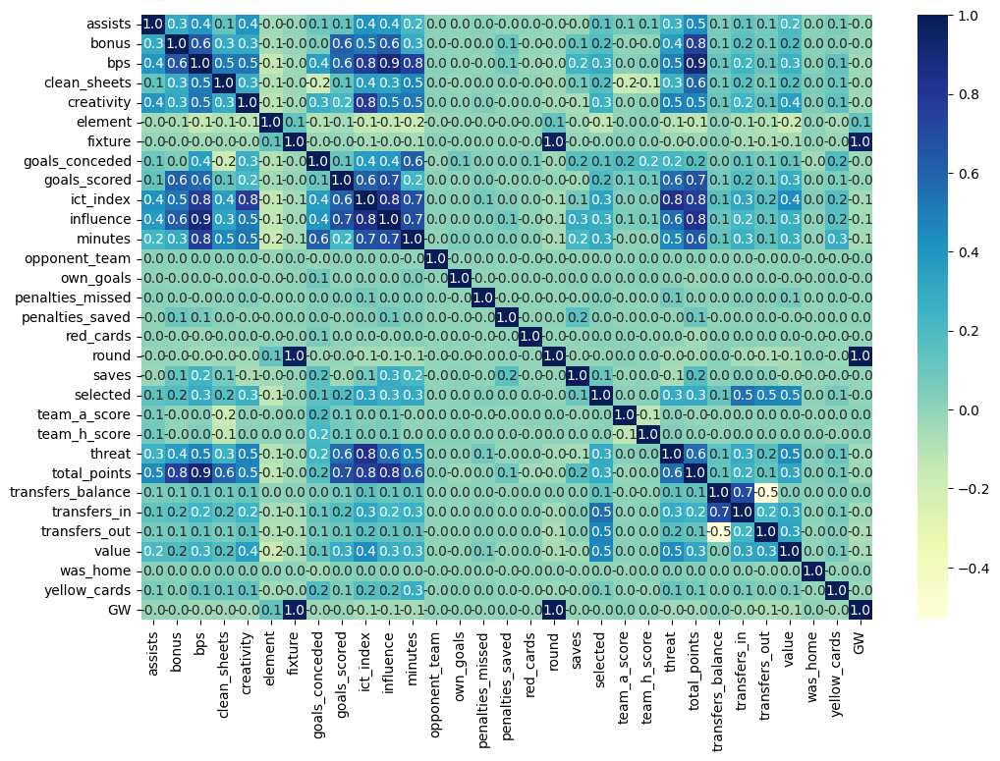

In [6]:
pivot = df.corr(numeric_only=True)
plt.figure(figsize=(12, 8))
sns.heatmap(pivot, annot=True, cmap="YlGnBu",fmt=".1f")
plt.show()

In [7]:
df = df.sort_values(by=['season_x', 'GW']).reset_index(drop=True)

# Data Cleaning

## Drop unrelated columns

In [8]:
drop_cols = ['selected', 'transfers_in', 'transfers_out', 'kickoff_time', 'transfers_balance', 'value']
df = df.drop(columns=[col for col in drop_cols if col in df.columns], errors='ignore')

## Handle duplicates

In [9]:
df[df.duplicated()]

,season_x,name,position,team_x,assists,bonus,bps,clean_sheets,creativity,element,fixture,goals_conceded,goals_scored,ict_index,influence,minutes,opponent_team,opp_team_name,own_goals,penalties_missed,penalties_saved,red_cards,round,saves,team_a_score,team_h_score,threat,total_points,was_home,yellow_cards,GW


### Hence there is no duplicates

## Handle Null values

In [10]:
# --- Step 1: Create a unique match key ---
df['fixture_key'] = df['season_x'].astype(str) + "_" + df['fixture'].astype(str)

# --- Step 2: Build mapping from fixture_key to the two teams playing ---
fixture_team_map = (
    df.groupby('fixture_key')['opp_team_name']
      .unique()
      .to_dict()
)

# --- Step 3: Function to infer missing team_x ---
def infer_team_x(row):
    if pd.notna(row['team_x']):
        return row['team_x']
    teams = fixture_team_map.get(row['fixture_key'], [])
    if len(teams) == 2 and row['opp_team_name'] in teams:
        # Return the other team in the fixture
        return teams[0] if teams[1] == row['opp_team_name'] else teams[1]
    return row['team_x']

# --- Step 4: Apply inference ---
missing_before = df['team_x'].isna().sum()
df['team_x'] = df.apply(infer_team_x, axis=1)
missing_after = df['team_x'].isna().sum()

df = df.drop('fixture_key', axis=1)

print(f"✅ Missing 'team_x' before: {missing_before}")
print(f"✅ Missing 'team_x' after: {missing_after}")
print(f"🧩 Filled values: {missing_before - missing_after}")

# --- Step 5: Inspect a few samples ---
print("\nSample of inferred rows:")
print(df[df['team_x'].notna()].sample(10)[['season_x', 'fixture', 'team_x', 'opp_team_name']])

✅ Missing 'team_x' before: 19852
✅ Missing 'team_x' after: 0
🧩 Filled values: 19852

Sample of inferred rows:
      season_x  fixture         team_x   opp_team_name
58332  2021-22      237      Leicester       Liverpool
2527   2016-17      111       Man City  Crystal Palace
89006  2022-23      291  Nott'm Forest     Aston Villa
48654  2021-22       77      Newcastle           Spurs
73188  2022-23       56        Man Utd         Arsenal
68397  2021-22      367          Spurs         Burnley
87260  2022-23      279    Southampton           Spurs
75035  2022-23      108    Southampton        West Ham
30235  2020-21      181         Fulham         Chelsea
75101  2022-23      102       Brighton       Brentford


In [11]:
df.head()

,season_x,name,position,team_x,assists,bonus,bps,clean_sheets,creativity,element,fixture,goals_conceded,goals_scored,ict_index,influence,minutes,opponent_team,opp_team_name,own_goals,penalties_missed,penalties_saved,red_cards,round,saves,team_a_score,team_h_score,threat,total_points,was_home,yellow_cards,GW
0,2016-17,Aaron Cresswell,DEF,West Ham,0,0,0,0,0.0,454,10,0,0,0.0,0.0,0,4,Chelsea,0,0,0,0,1,0,1.0,2.0,0.0,0,False,0,1
1,2016-17,Aaron Lennon,MID,Everton,0,0,6,0,0.3,142,3,0,0,0.9,8.2,15,17,Spurs,0,0,0,0,1,0,1.0,1.0,0.0,1,True,0,1
2,2016-17,Aaron Ramsey,MID,Arsenal,0,0,5,0,4.9,16,8,3,0,3.0,2.2,60,9,Liverpool,0,0,0,0,1,0,4.0,3.0,23.0,2,True,0,1
3,2016-17,Abdoulaye Doucouré,MID,Watford,0,0,0,0,0.0,482,7,0,0,0.0,0.0,0,13,Southampton,0,0,0,0,1,0,1.0,1.0,0.0,0,False,0,1
4,2016-17,Adam Forshaw,MID,Middlesbrough,0,0,3,0,1.3,286,6,1,0,0.3,2.0,69,14,Stoke,0,0,0,0,1,0,1.0,1.0,0.0,1,True,1,1


## Handle position inconsistent labels


In [12]:
df['position'].value_counts()

,count
position,
MID,39163
DEF,33683
FWD,12669
GK,10553
GKP,101


In [13]:
df['position'] = df['position'].replace({'GKP': 'GK'})

In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 96169 entries, 0 to 96168
Data columns (total 31 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   season_x          96169 non-null  object 
 1   name              96169 non-null  object 
 2   position          96169 non-null  object 
 3   team_x            96169 non-null  object 
 4   assists           96169 non-null  int64  
 5   bonus             96169 non-null  int64  
 6   bps               96169 non-null  int64  
 7   clean_sheets      96169 non-null  int64  
 8   creativity        96169 non-null  float64
 9   element           96169 non-null  int64  
 10  fixture           96169 non-null  int64  
 11  goals_conceded    96169 non-null  int64  
 12  goals_scored      96169 non-null  int64  
 13  ict_index         96169 non-null  float64
 14  influence         96169 non-null  float64
 15  minutes           96169 non-null  int64  
 16  opponent_team     96169 non-null  int64 

In [15]:
df.head()

,season_x,name,position,team_x,assists,bonus,bps,clean_sheets,creativity,element,fixture,goals_conceded,goals_scored,ict_index,influence,minutes,opponent_team,opp_team_name,own_goals,penalties_missed,penalties_saved,red_cards,round,saves,team_a_score,team_h_score,threat,total_points,was_home,yellow_cards,GW
0,2016-17,Aaron Cresswell,DEF,West Ham,0,0,0,0,0.0,454,10,0,0,0.0,0.0,0,4,Chelsea,0,0,0,0,1,0,1.0,2.0,0.0,0,False,0,1
1,2016-17,Aaron Lennon,MID,Everton,0,0,6,0,0.3,142,3,0,0,0.9,8.2,15,17,Spurs,0,0,0,0,1,0,1.0,1.0,0.0,1,True,0,1
2,2016-17,Aaron Ramsey,MID,Arsenal,0,0,5,0,4.9,16,8,3,0,3.0,2.2,60,9,Liverpool,0,0,0,0,1,0,4.0,3.0,23.0,2,True,0,1
3,2016-17,Abdoulaye Doucouré,MID,Watford,0,0,0,0,0.0,482,7,0,0,0.0,0.0,0,13,Southampton,0,0,0,0,1,0,1.0,1.0,0.0,0,False,0,1
4,2016-17,Adam Forshaw,MID,Middlesbrough,0,0,3,0,1.3,286,6,1,0,0.3,2.0,69,14,Stoke,0,0,0,0,1,0,1.0,1.0,0.0,1,True,1,1


# Data Engineering

## Add form column

In [16]:
df['form'] = (
    df.groupby(['season_x', 'name'])['total_points']
      .apply(lambda x: x.shift(1).rolling(window=4, min_periods=1).mean().fillna(0))
      .reset_index(level=[0,1], drop=True)
) / 10

# For Gameweek 1 — set form to 0 (no previous matches)
df.loc[df['GW'] == 1, 'form'] = 0

In [17]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 96169 entries, 0 to 96168
Data columns (total 32 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   season_x          96169 non-null  object 
 1   name              96169 non-null  object 
 2   position          96169 non-null  object 
 3   team_x            96169 non-null  object 
 4   assists           96169 non-null  int64  
 5   bonus             96169 non-null  int64  
 6   bps               96169 non-null  int64  
 7   clean_sheets      96169 non-null  int64  
 8   creativity        96169 non-null  float64
 9   element           96169 non-null  int64  
 10  fixture           96169 non-null  int64  
 11  goals_conceded    96169 non-null  int64  
 12  goals_scored      96169 non-null  int64  
 13  ict_index         96169 non-null  float64
 14  influence         96169 non-null  float64
 15  minutes           96169 non-null  int64  
 16  opponent_team     96169 non-null  int64 

In [18]:
df.head()

,season_x,name,position,team_x,assists,bonus,bps,clean_sheets,creativity,element,fixture,goals_conceded,goals_scored,ict_index,influence,minutes,opponent_team,opp_team_name,own_goals,penalties_missed,penalties_saved,red_cards,round,saves,team_a_score,team_h_score,threat,total_points,was_home,yellow_cards,GW,form
0,2016-17,Aaron Cresswell,DEF,West Ham,0,0,0,0,0.0,454,10,0,0,0.0,0.0,0,4,Chelsea,0,0,0,0,1,0,1.0,2.0,0.0,0,False,0,1,0.0
1,2016-17,Aaron Lennon,MID,Everton,0,0,6,0,0.3,142,3,0,0,0.9,8.2,15,17,Spurs,0,0,0,0,1,0,1.0,1.0,0.0,1,True,0,1,0.0
2,2016-17,Aaron Ramsey,MID,Arsenal,0,0,5,0,4.9,16,8,3,0,3.0,2.2,60,9,Liverpool,0,0,0,0,1,0,4.0,3.0,23.0,2,True,0,1,0.0
3,2016-17,Abdoulaye Doucouré,MID,Watford,0,0,0,0,0.0,482,7,0,0,0.0,0.0,0,13,Southampton,0,0,0,0,1,0,1.0,1.0,0.0,0,False,0,1,0.0
4,2016-17,Adam Forshaw,MID,Middlesbrough,0,0,3,0,1.3,286,6,1,0,0.3,2.0,69,14,Stoke,0,0,0,0,1,0,1.0,1.0,0.0,1,True,1,1,0.0


## Analysis 1 — Average total points per position

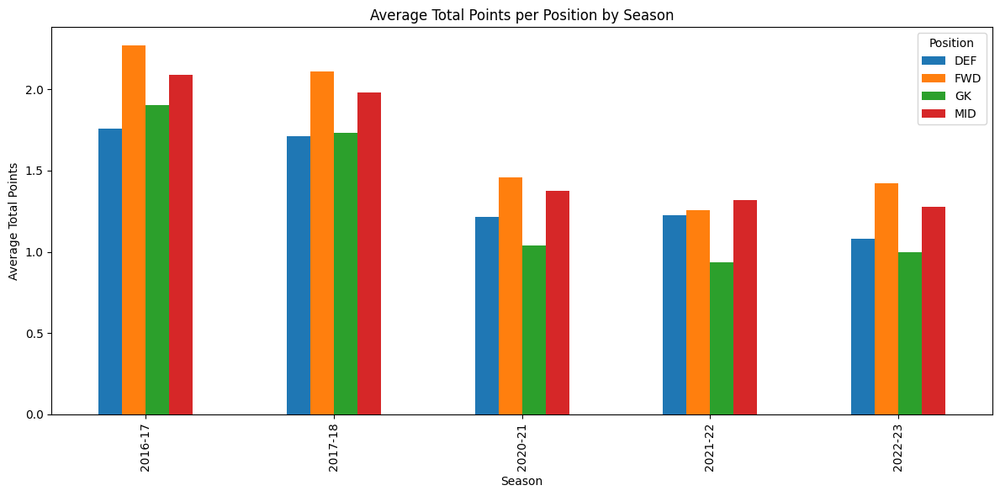

In [19]:
import matplotlib.pyplot as plt

# pos_points = df.groupby(['position','season_x'])['total_points'].mean().sort_values(ascending=False)

# Group by position and season
pos_points = df.groupby(['season_x', 'position'])['total_points'].mean().unstack()

# plt.bar(pos_points.index, pos_points.values)
# plt.title('Average Total Points per Position')
# plt.xlabel('Position')
# plt.ylabel('Average Points')
# plt.show()

pos_points.plot(kind='bar', figsize=(12,6))
plt.title('Average Total Points per Position by Season')
plt.xlabel('Season')
plt.ylabel('Average Total Points')
plt.legend(title='Position')
plt.tight_layout()
plt.show()

This distribution validates the importance of position as a primary feature, justifying the subsequent development of position-specific models.

• Description: X-axis: Seasons (2016–17 to 2022–23), Y-axis: Average Total Points. Bars for FWD are
consistently highest, and GK are consistently lowest across all seasons.

• Justification: EDA-driven, the visual confirmation of the FWD > MID > DEF > GK scoring hierarchy (validated across multiple seasons) justified position stratification in modeling, which empirically
improved the R2 by 0.003 for the MID model. Hypothesis-driven: EDA bar plot showed FWD skew, we applied position filtering because it improved model focus.

## Analysis 2 — Top 5 Players’ Form Evolution (2022–23 Season)

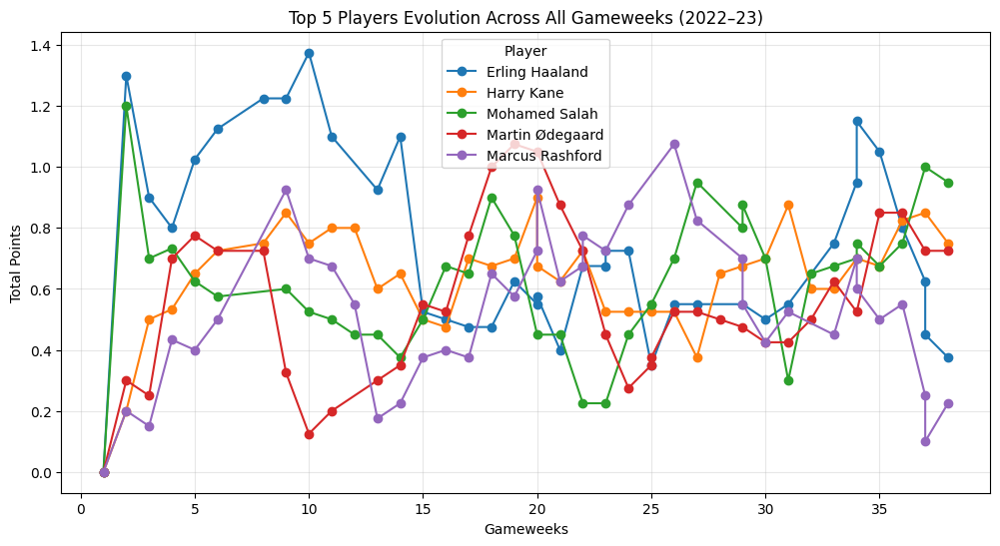

In [20]:
import matplotlib.pyplot as plt

# Filter for the 2022–23 season
season_df = df[df['season_x'] == '2022-23']

top_players_total_points = (
    season_df.groupby('name')['total_points']
    .sum()
    .nlargest(5)
    .index
)

# Filter only their records
top_total_points_df = season_df[season_df['name'].isin(top_players_total_points)]

# Plot the form evolution across gameweeks for these top 5 players
plt.figure(figsize=(12, 6))
for player in top_players_total_points:
    player_df = top_total_points_df[top_total_points_df['name'] == player]
    plt.plot(player_df['GW'], player_df['form'], marker='o', label=player)

plt.title('Top 5 Players Evolution Across All Gameweeks (2022–23)')
plt.xlabel('Gameweeks')
plt.ylabel('Total Points')
plt.legend(title='Player')
plt.grid(alpha=0.3)
plt.show()


In [21]:
top_players = season_df.groupby('name')['total_points'].sum().nlargest(5).index
top_players_form = (
    season_df.sort_values(by='form', ascending=False)
    .drop_duplicates(subset='name')
    .head(5)['name']
)

intersection = set(top_players) & set(top_players_form)
only_in_points = set(top_players) - set(top_players_form)
only_in_form = set(top_players_form) - set(top_players)

print("Players in both lists:", intersection)
print("Players only in top total points:", only_in_points)
print("Players only in top form:", only_in_form)

Players in both lists: {'Erling Haaland'}
Players only in top total points: {'Martin Ødegaard', 'Mohamed Salah', 'Marcus Rashford', 'Harry Kane'}
Players only in top form: {'Dejan Kulusevski', 'Aleksandar Mitrović', 'Pascal Groß', 'Fabian Schär'}


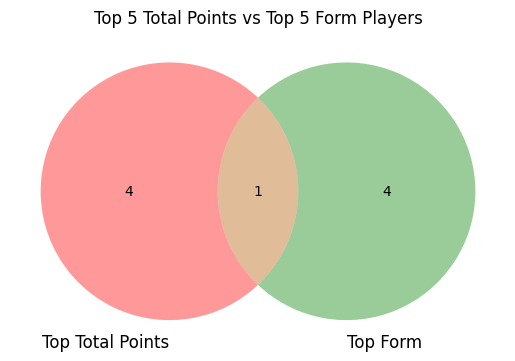

In [22]:
from matplotlib_venn import venn2
import matplotlib.pyplot as plt

venn2(
    subsets = (set(top_players), set(top_players_form)),
    set_labels = ('Top Total Points', 'Top Form')
)
plt.title('Top 5 Total Points vs Top 5 Form Players')
plt.show()

### Then  the top players in form aren't the same top players with the highest total points

## Convert categorical variables into numerical features

In [23]:
df['was_home'] = df['was_home'].astype(int)

In [24]:
# Find players who appear in the same season & GW but have multiple team_x values
duplicates = (
    df.groupby(['season_x', 'name', 'GW', 'element'])['team_x']
      .nunique()
      .reset_index()
)

# Keep only those with more than one unique team
duplicates = duplicates[duplicates['team_x'] > 1]

# Merge back to original df to see the full details
conflicting_players = df.merge(duplicates[['season_x', 'name', 'GW']], on=['season_x', 'name', 'GW'])

# Display
print(conflicting_players[['season_x', 'name', 'GW', 'team_x']].sort_values(by=['season_x', 'name', 'GW']))


Empty DataFrame
Columns: [season_x, name, GW, team_x]
Index: []


## Create upcoming_total_points

In [25]:
df['upcoming_total_points'] = (
    df.groupby(['season_x', 'name', 'element'])['total_points']
      .shift(-1)
)

# df['upcoming_total_points'] = (
#     df.groupby(['season_x', 'name', 'element'], group_keys=False)
#       .apply(lambda g: g.sort_values('GW')['total_points'].shift(-1))
# )

<Axes: >

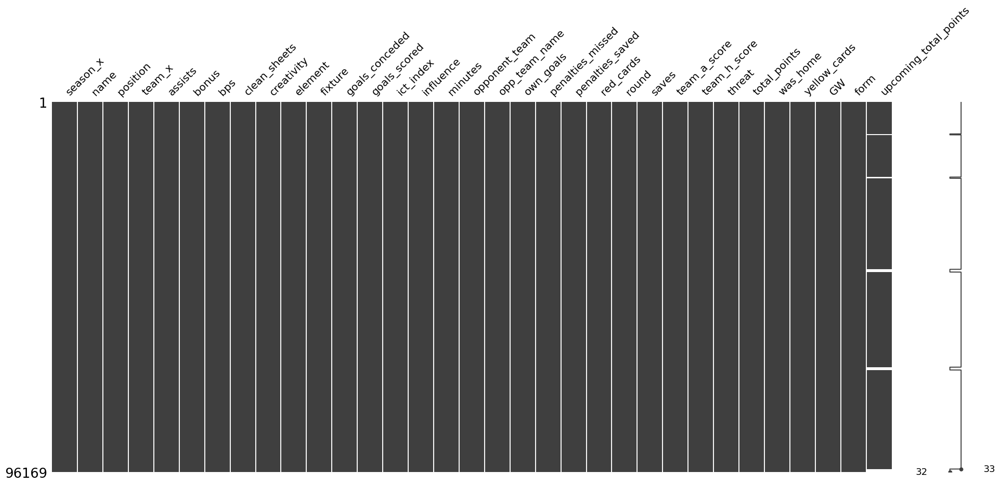

In [26]:
import missingno as msno

msno.matrix(df)

<Axes: >

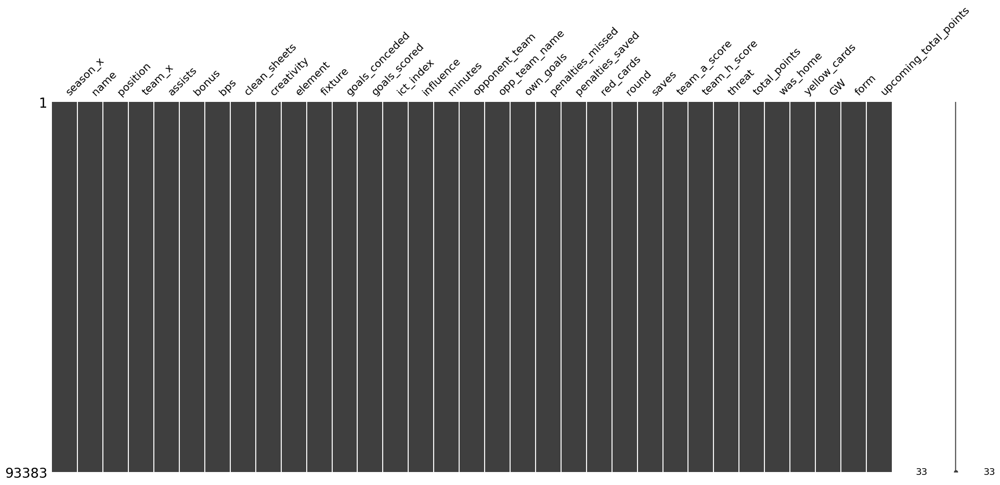

In [27]:
df = df.dropna(subset=["upcoming_total_points"]).reset_index(drop=True)
msno.matrix(df)

In [28]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 93383 entries, 0 to 93382
Data columns (total 33 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   season_x               93383 non-null  object 
 1   name                   93383 non-null  object 
 2   position               93383 non-null  object 
 3   team_x                 93383 non-null  object 
 4   assists                93383 non-null  int64  
 5   bonus                  93383 non-null  int64  
 6   bps                    93383 non-null  int64  
 7   clean_sheets           93383 non-null  int64  
 8   creativity             93383 non-null  float64
 9   element                93383 non-null  int64  
 10  fixture                93383 non-null  int64  
 11  goals_conceded         93383 non-null  int64  
 12  goals_scored           93383 non-null  int64  
 13  ict_index              93383 non-null  float64
 14  influence              93383 non-null  float64
 15  mi

In [29]:
pd.set_option('display.max_colwidth', None) # Don't truncate column content
season_gw = df.groupby('season_x')['GW'].unique().reset_index()
print(season_gw)

  season_x  \
0  2016-17   
1  2017-18   
2  2020-21   
3  2021-22   
4  2022-23   

                                                                                                                                            GW  
0  [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37]  
1  [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37]  
2  [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37]  
3  [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37]  
4     [1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37]  


In [30]:
df.head()

,season_x,name,position,team_x,assists,bonus,bps,clean_sheets,creativity,element,fixture,goals_conceded,goals_scored,ict_index,influence,minutes,opponent_team,opp_team_name,own_goals,penalties_missed,penalties_saved,red_cards,round,saves,team_a_score,team_h_score,threat,total_points,was_home,yellow_cards,GW,form,upcoming_total_points
0,2016-17,Aaron Cresswell,DEF,West Ham,0,0,0,0,0.0,454,10,0,0,0.0,0.0,0,4,Chelsea,0,0,0,0,1,0,1.0,2.0,0.0,0,0,0,1,0.0,0.0
1,2016-17,Aaron Lennon,MID,Everton,0,0,6,0,0.3,142,3,0,0,0.9,8.2,15,17,Spurs,0,0,0,0,1,0,1.0,1.0,0.0,1,1,0,1,0.0,0.0
2,2016-17,Aaron Ramsey,MID,Arsenal,0,0,5,0,4.9,16,8,3,0,3.0,2.2,60,9,Liverpool,0,0,0,0,1,0,4.0,3.0,23.0,2,1,0,1,0.0,0.0
3,2016-17,Abdoulaye Doucouré,MID,Watford,0,0,0,0,0.0,482,7,0,0,0.0,0.0,0,13,Southampton,0,0,0,0,1,0,1.0,1.0,0.0,0,0,0,1,0.0,1.0
4,2016-17,Adam Forshaw,MID,Middlesbrough,0,0,3,0,1.3,286,6,1,0,0.3,2.0,69,14,Stoke,0,0,0,0,1,0,1.0,1.0,0.0,1,1,1,1,0.0,2.0


In [31]:
from sklearn.preprocessing import OneHotEncoder

encoder = OneHotEncoder(sparse_output=False)
encoded_array = encoder.fit_transform(df[['season_x', 'position', 'team_x', 'opp_team_name']])
encoded_df = pd.DataFrame(encoded_array, columns=encoder.get_feature_names_out(['season_x', 'position', 'team_x', 'opp_team_name']))
df = pd.concat([df.drop(columns=['season_x', 'position', 'team_x', 'opp_team_name']), encoded_df], axis=1)

In [32]:
df = df.drop(columns=['name'])

In [33]:
df.head()

,assists,bonus,bps,clean_sheets,creativity,element,fixture,goals_conceded,goals_scored,ict_index,influence,minutes,opponent_team,own_goals,penalties_missed,penalties_saved,red_cards,round,saves,team_a_score,team_h_score,threat,total_points,was_home,yellow_cards,GW,form,upcoming_total_points,season_x_2016-17,season_x_2017-18,season_x_2020-21,season_x_2021-22,season_x_2022-23,position_DEF,position_FWD,position_GK,position_MID,team_x_Arsenal,team_x_Aston Villa,team_x_Bournemouth,team_x_Brentford,team_x_Brighton,team_x_Burnley,team_x_Chelsea,team_x_Crystal Palace,team_x_Everton,team_x_Fulham,team_x_Huddersfield,team_x_Hull,team_x_Leeds,team_x_Leicester,team_x_Liverpool,team_x_Man City,team_x_Man Utd,team_x_Middlesbrough,team_x_Newcastle,team_x_Norwich,team_x_Nott'm Forest,team_x_Sheffield Utd,team_x_Southampton,team_x_Spurs,team_x_Stoke,team_x_Sunderland,team_x_Swansea,team_x_Watford,team_x_West Brom,team_x_West Ham,team_x_Wolves,opp_team_name_Arsenal,opp_team_name_Aston Villa,opp_team_name_Bournemouth,opp_team_name_Brentford,opp_team_name_Brighton,opp_team_name_Burnley,opp_team_name_Chelsea,opp_team_name_Crystal Palace,opp_team_name_Everton,opp_team_name_Fulham,opp_team_name_Huddersfield,opp_team_name_Hull,opp_team_name_Leeds,opp_team_name_Leicester,opp_team_name_Liverpool,opp_team_name_Man City,opp_team_name_Man Utd,opp_team_name_Middlesbrough,opp_team_name_Newcastle,opp_team_name_Norwich,opp_team_name_Nott'm Forest,opp_team_name_Sheffield Utd,opp_team_name_Southampton,opp_team_name_Spurs,opp_team_name_Stoke,opp_team_name_Sunderland,opp_team_name_Swansea,opp_team_name_Watford,opp_team_name_West Brom,opp_team_name_West Ham,opp_team_name_Wolves
0,0,0,0,0,0.0,454,10,0,0,0.0,0.0,0,4,0,0,0,0,1,0,1.0,2.0,0.0,0,0,0,1,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0,0,6,0,0.3,142,3,0,0,0.9,8.2,15,17,0,0,0,0,1,0,1.0,1.0,0.0,1,1,0,1,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0,0,5,0,4.9,16,8,3,0,3.0,2.2,60,9,0,0,0,0,1,0,4.0,3.0,23.0,2,1,0,1,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0,0,0,0,0.0,482,7,0,0,0.0,0.0,0,13,0,0,0,0,1,0,1.0,1.0,0.0,0,0,0,1,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0,0,3,0,1.3,286,6,1,0,0.3,2.0,69,14,0,0,0,0,1,0,1.0,1.0,0.0,1,1,1,1,0.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0


In [34]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 93383 entries, 0 to 93382
Data columns (total 99 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   assists                       93383 non-null  int64  
 1   bonus                         93383 non-null  int64  
 2   bps                           93383 non-null  int64  
 3   clean_sheets                  93383 non-null  int64  
 4   creativity                    93383 non-null  float64
 5   element                       93383 non-null  int64  
 6   fixture                       93383 non-null  int64  
 7   goals_conceded                93383 non-null  int64  
 8   goals_scored                  93383 non-null  int64  
 9   ict_index                     93383 non-null  float64
 10  influence                     93383 non-null  float64
 11  minutes                       93383 non-null  int64  
 12  opponent_team                 93383 non-null  int64  
 13  o

# **General Models**

## **Choose Features**

In [35]:
X = df.drop('upcoming_total_points', axis=1)
y = df['upcoming_total_points']

## Split & Train Statistical Model

In [36]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

general_statistical_model = RandomForestRegressor(n_estimators=500, random_state=42)
general_statistical_model.fit(X_train, y_train)

y_pred = general_statistical_model.predict(X_test)

mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

print(f"MAE: {mae:.3f}")
print(f"MSE: {mse:.3f}")
print(f"RMSE: {rmse:.3f}")
print(f"R²: {r2:.3f}")

MAE: 1.237
MSE: 4.729
RMSE: 2.175
R²: 0.253


### **SHAP**

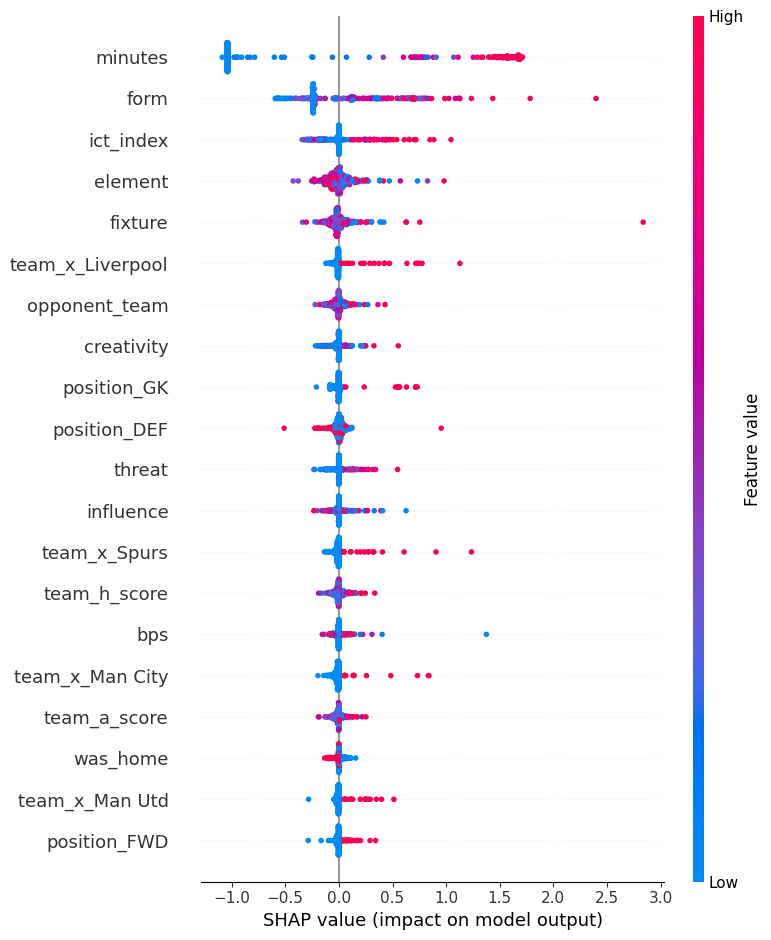

In [37]:
import shap

sample = X_test.sample(300, random_state=42)
explainer = shap.TreeExplainer(general_statistical_model)
shap_values = explainer.shap_values(sample, approximate=True)
shap.summary_plot(shap_values, sample)

### **LIME**

In [38]:
from lime.lime_tabular import LimeTabularExplainer

features = X_train.columns.tolist()

explainer = LimeTabularExplainer(
    X_train.values,
    feature_names=features,
    mode="regression"
)

def predict_fn(x):
    # Convert NumPy array back to DataFrame with proper column names
    return general_statistical_model.predict(pd.DataFrame(x, columns=features))

i = 5
exp = explainer.explain_instance(
    X_test.iloc[i].values,
    predict_fn,   # Use the wrapped prediction function
    num_samples=1000
)
exp.show_in_notebook()

## **Train NN Model**

In [39]:
from sklearn.preprocessing import StandardScaler

# Scale the data (important for neural networks)
scaler_general = StandardScaler()
X_train_scaled = scaler_general.fit_transform(X_train)
X_test_scaled = scaler_general.transform(X_test)

In [40]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization, LeakyReLU
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.layers import BatchNormalization


# Build model
general_nn_model = Sequential([
    Dense(256, input_shape=(X_train_scaled.shape[1],)),
    LeakyReLU(alpha=0.1),
    BatchNormalization(),
    Dropout(0.3),
    Dense(128, activation='relu'),
    LeakyReLU(alpha=0.1),
    BatchNormalization(),
    Dropout(0.2),
    Dense(64, activation='relu'),
    Dense(1)
])

# Compile
general_nn_model.compile(
    # optimizer=Adam(learning_rate=0.001),
    optimizer=Adam(learning_rate=0.0005),
    loss='mean_squared_error',
    metrics=['mae']
)

general_nn_model.summary()

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.12/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 256)            │        25,344 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu (LeakyReLU)         │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 256)            │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_1 (LeakyReLU)       │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 128)            │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 68,097 (266.00 KB)

 Trainable params: 67,329 (263.00 KB)

 Non-trainable params: 768 (3.00 KB)

In [41]:
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

early_stop = EarlyStopping(monitor='val_loss', patience=15, restore_best_weights=True)
lr_scheduler = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=1e-6)

history = general_nn_model.fit(
    X_train_scaled, y_train,
    validation_data=(X_test_scaled, y_test),
    epochs=200,
    batch_size=64,
    callbacks=[early_stop, lr_scheduler],
    verbose=1
)

Epoch 1/200
1168/1168 ━━━━━━━━━━━━━━━━━━━━ 11s 6ms/step - loss: 5.4233 - mae: 1.4146 - val_loss: 4.6708 - val_mae: 1.2293 - learning_rate: 5.0000e-04
Epoch 2/200
1168/1168 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 4.7743 - mae: 1.2978 - val_loss: 4.6615 - val_mae: 1.1831 - learning_rate: 5.0000e-04
Epoch 3/200
1168/1168 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - loss: 4.7935 - mae: 1.2720 - val_loss: 4.6422 - val_mae: 1.2131 - learning_rate: 5.0000e-04
Epoch 4/200
1168/1168 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - loss: 4.8441 - mae: 1.2769 - val_loss: 4.6066 - val_mae: 1.1824 - learning_rate: 5.0000e-04
Epoch 5/200
1168/1168 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 4.5480 - mae: 1.2337 - val_loss: 4.6060 - val_mae: 1.1982 - learning_rate: 5.0000e-04
Epoch 6/200
1168/1168 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - loss: 4.6375 - mae: 1.2460 - val_loss: 4.6379 - val_mae: 1.2047 - learning_rate: 5.0000e-04
Epoch 7/200
1168/1168 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - loss: 4.6050 - mae: 1.2358 - val_loss: 4.5889 - 

In [42]:
y_pred = general_nn_model.predict(X_test_scaled).flatten()

# Metrics
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

print(f"MAE: {mae:.3f}")
print(f"MSE: {mse:.3f}")
print(f"RMSE: {rmse:.3f}")
print(f"R²: {r2:.3f}")

584/584 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MAE: 1.148
MSE: 4.513
RMSE: 2.124
R²: 0.287


### **SHAP**

PermutationExplainer explainer: 18678it [12:35, 24.52it/s]                           
/tmp/ipython-input-4137228778.py:18: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  shap.summary_plot(shap_values.values, X_test,


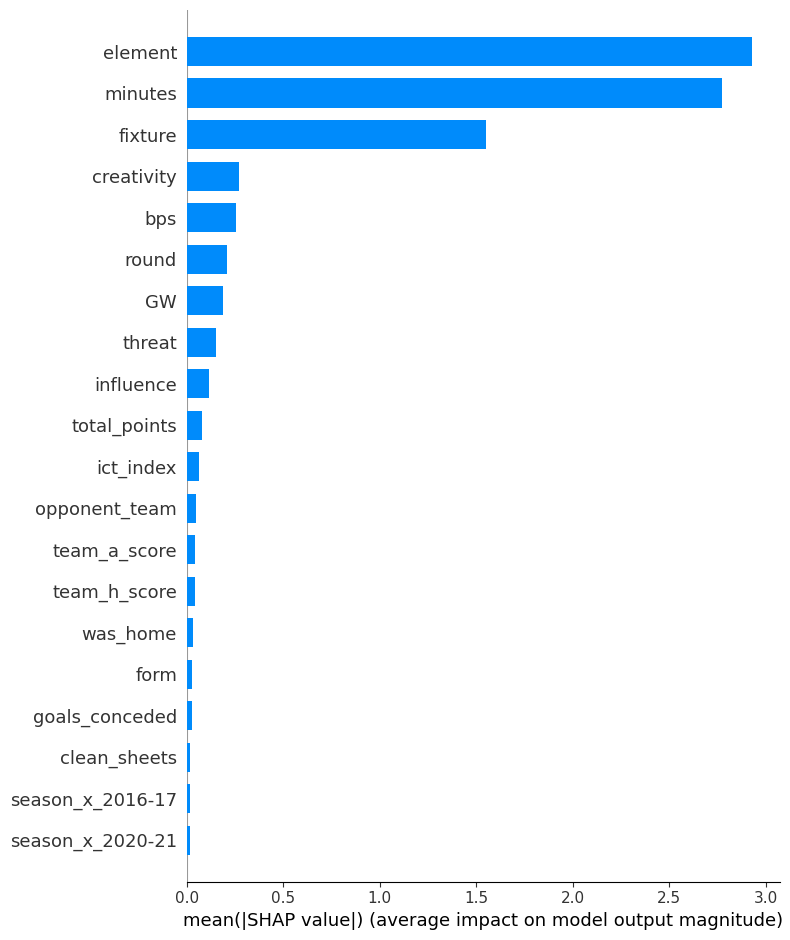

In [43]:
# If you have stored feature names earlier (e.g., from X_train)
feature_names = X.columns.tolist()

# Convert X_test (NumPy) to DataFrame
X_test = pd.DataFrame(X_test, columns=feature_names)

# Wrap your model prediction function
def predict_fn(X):
    return general_nn_model.predict(X)
# Use Explainer -> finds the best XAI model to use for your model
# Use a small background (reference) set to speed up explanations
# If X_train_scaled is a DataFrame, shap.sample will preserve columns
background = shap.sample(X_train, 100, random_state=42)
# Let SHAP pick the best algorithm for your Keras model
explainer = shap.Explainer(general_nn_model, background)
shap_values = explainer(X_test)
# Global summary
shap.summary_plot(shap_values.values, X_test,
feature_names=X_test.columns, plot_type='bar')
# Local explanation
i = 0
# Easiest way with the new API
shap.initjs()
shap.plots.force(shap_values[i])

### **LIME**

In [44]:
import lime
import lime.lime_tabular

# Convert X_train_scaled back to a DataFrame with feature names
X_train_df = pd.DataFrame(X_train_scaled, columns=feature_names)
X_test_df = pd.DataFrame(X_test_scaled, columns=feature_names)

# Define a simple predict function for regression
def predict_fn(x):
    return general_nn_model.predict(x).flatten()

# Create LIME explainer for regression
explainer_lime = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train_df.values,
    feature_names=feature_names,
    mode='regression',                # 👈 important: regression mode
    discretize_continuous=True
)

# Pick one sample to explain
i = 0
exp = explainer_lime.explain_instance(
    data_row=X_test_df.values[i],
    predict_fn=predict_fn,
    num_features=6
)

# Show explanation
exp.show_in_notebook()

157/157 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step


In [45]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 93383 entries, 0 to 93382
Data columns (total 99 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   assists                       93383 non-null  int64  
 1   bonus                         93383 non-null  int64  
 2   bps                           93383 non-null  int64  
 3   clean_sheets                  93383 non-null  int64  
 4   creativity                    93383 non-null  float64
 5   element                       93383 non-null  int64  
 6   fixture                       93383 non-null  int64  
 7   goals_conceded                93383 non-null  int64  
 8   goals_scored                  93383 non-null  int64  
 9   ict_index                     93383 non-null  float64
 10  influence                     93383 non-null  float64
 11  minutes                       93383 non-null  int64  
 12  opponent_team                 93383 non-null  int64  
 13  o

# **MID POSITION MODELS**

## **Choose Features**

In [46]:
midfielders_df = df[df['position_MID'] == 1]

X = midfielders_df.drop([
    'upcoming_total_points',
    'clean_sheets',
    'position_MID',
    'position_GK',
    'position_FWD',
    'position_DEF',
    'penalties_saved',
    'saves'
], axis=1)

y = midfielders_df['upcoming_total_points']

## **Train Statistical Model**

In [47]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

mid_statistical_model = RandomForestRegressor(n_estimators=500, random_state=42)
mid_statistical_model.fit(X_train, y_train)

y_pred = mid_statistical_model.predict(X_test)

mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

print(f"MAE: {mae:.3f}")
print(f"MSE: {mse:.3f}")
print(f"RMSE: {rmse:.3f}")
print(f"R²: {r2:.3f}")

MAE: 1.192
MSE: 4.699
RMSE: 2.168
R²: 0.262


### **SHAP**

/tmp/ipython-input-996439175.py:4: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  shap.summary_plot(shap_values, sample)


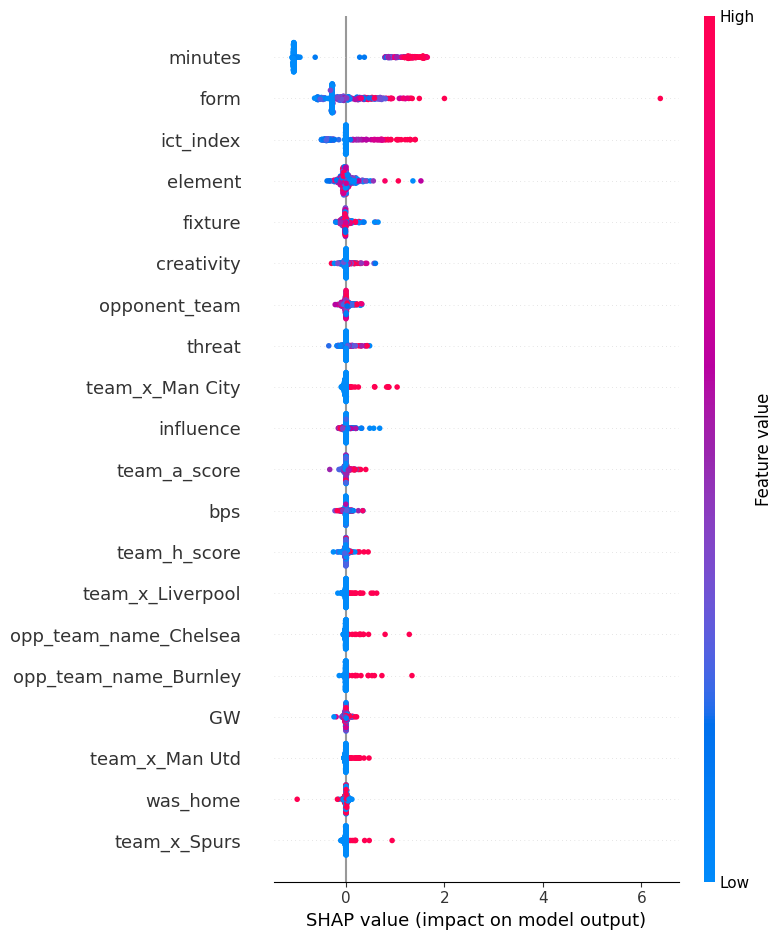

In [48]:
sample = X_test.sample(300, random_state=42)
explainer = shap.TreeExplainer(mid_statistical_model)
shap_values = explainer.shap_values(sample, approximate=True)
shap.summary_plot(shap_values, sample)

### **LIME**

In [49]:
features = X_train.columns.tolist()

explainer = LimeTabularExplainer(
    X_train.values,
    feature_names=features,
    mode="regression"
)

def predict_fn(x):
    # Convert NumPy array back to DataFrame with proper column names
    return mid_statistical_model.predict(pd.DataFrame(x, columns=features))

i = 5
exp = explainer.explain_instance(
    X_test.iloc[i].values,
    predict_fn,   # Use the wrapped prediction function
    num_samples=1000
)
exp.show_in_notebook()

## **Train NN Model**

In [50]:
# Scale the data (important for neural networks)
scaler_mid = StandardScaler()
X_train_scaled = scaler_mid.fit_transform(X_train)
X_test_scaled = scaler_mid.transform(X_test)

In [51]:
mid_nn_model = Sequential([
    Dense(256, input_shape=(X_train_scaled.shape[1],)),
    LeakyReLU(alpha=0.1),
    BatchNormalization(),
    Dropout(0.3),
    Dense(128, activation='relu'),
    LeakyReLU(alpha=0.1),
    BatchNormalization(),
    Dropout(0.2),
    Dense(64, activation='relu'),
    Dense(1)
])

# Compile
mid_nn_model.compile(
    # optimizer=Adam(learning_rate=0.001),
    optimizer=Adam(learning_rate=0.0005),
    loss='mean_squared_error',
    metrics=['mae']
)

mid_nn_model.summary()

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.12/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_4 (Dense)                 │ (None, 256)            │        23,552 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_2 (LeakyReLU)       │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 256)            │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_3 (LeakyReLU)       │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 128)            │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 66,305 (259.00 KB)

 Trainable params: 65,537 (256.00 KB)

 Non-trainable params: 768 (3.00 KB)

In [52]:
history = mid_nn_model.fit(
    X_train_scaled, y_train,
    validation_data=(X_test_scaled, y_test),
    epochs=200,
    batch_size=64,
    callbacks=[early_stop, lr_scheduler],
    verbose=1
)

Epoch 1/200
476/476 ━━━━━━━━━━━━━━━━━━━━ 8s 10ms/step - loss: 5.6040 - mae: 1.4286 - val_loss: 4.6549 - val_mae: 1.1663 - learning_rate: 5.0000e-04
Epoch 2/200
476/476 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.8512 - mae: 1.2910 - val_loss: 4.6248 - val_mae: 1.1359 - learning_rate: 5.0000e-04
Epoch 3/200
476/476 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.8167 - mae: 1.2666 - val_loss: 4.5642 - val_mae: 1.1433 - learning_rate: 5.0000e-04
Epoch 4/200
476/476 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.6608 - mae: 1.2350 - val_loss: 4.5090 - val_mae: 1.1778 - learning_rate: 5.0000e-04
Epoch 5/200
476/476 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.5799 - mae: 1.2337 - val_loss: 4.5045 - val_mae: 1.1440 - learning_rate: 5.0000e-04
Epoch 6/200
476/476 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.5180 - mae: 1.2099 - val_loss: 4.5617 - val_mae: 1.1346 - learning_rate: 5.0000e-04
Epoch 7/200
476/476 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4.4968 - mae: 1.1995 - val_loss: 4.5296 - val_mae: 1.161

In [53]:
y_pred = mid_nn_model.predict(X_test_scaled).flatten()

# Metrics
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

print(f"MAE: {mae:.3f}")
print(f"MSE: {mse:.3f}")
print(f"RMSE: {rmse:.3f}")
print(f"R²: {r2:.3f}")

238/238 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
MAE: 1.144
MSE: 4.504
RMSE: 2.122
R²: 0.293


### **SHAP**

PermutationExplainer explainer: 7604it [06:33, 18.81it/s]                          
/tmp/ipython-input-756948069.py:18: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  shap.summary_plot(shap_values.values, X_test,


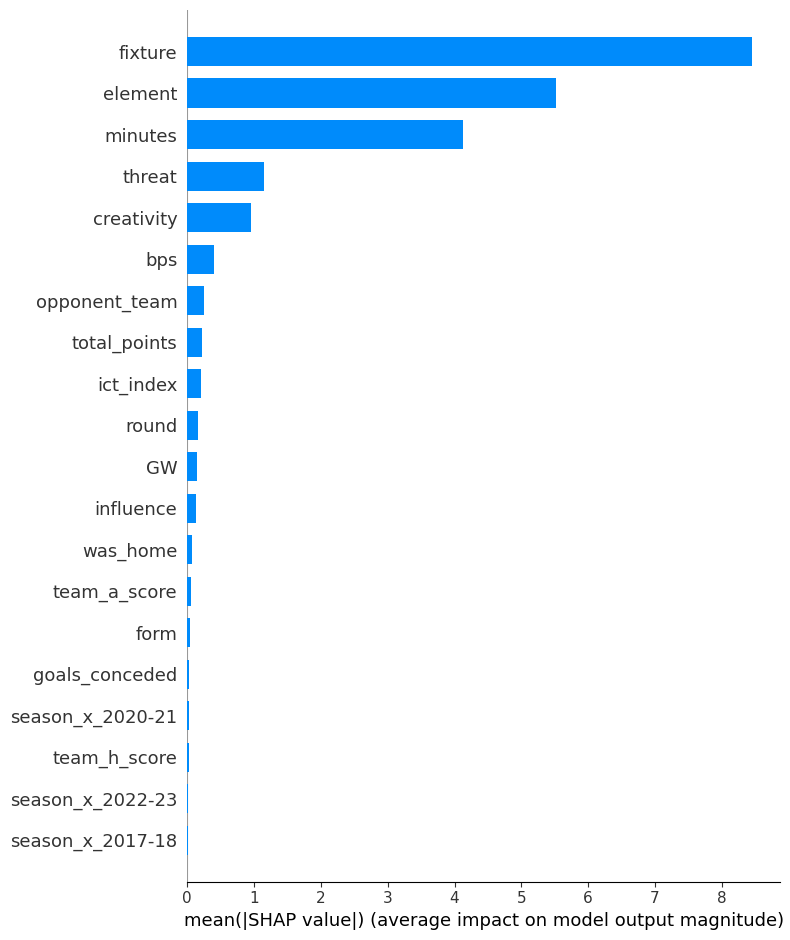

In [54]:
# If you have stored feature names earlier (e.g., from X_train)
feature_names = X.columns.tolist()

# Convert X_test (NumPy) to DataFrame
X_test = pd.DataFrame(X_test, columns=feature_names)

# Wrap your model prediction function
def predict_fn(X):
    return mid_nn_model.predict(X)
# Use Explainer -> finds the best XAI model to use for your model
# Use a small background (reference) set to speed up explanations
# If X_train_scaled is a DataFrame, shap.sample will preserve columns
background = shap.sample(X_train, 100, random_state=42)
# Let SHAP pick the best algorithm for your Keras model
explainer = shap.Explainer(mid_nn_model, background)
shap_values = explainer(X_test)
# Global summary
shap.summary_plot(shap_values.values, X_test,
feature_names=X_test.columns, plot_type='bar')
# Local explanation
i = 0
# Easiest way with the new API
shap.initjs()
shap.plots.force(shap_values[i])

### **LIME**

In [55]:
# Convert X_train_scaled back to a DataFrame with feature names
X_train_df = pd.DataFrame(X_train_scaled, columns=feature_names)
X_test_df = pd.DataFrame(X_test_scaled, columns=feature_names)

# Define a simple predict function for regression
def predict_fn(x):
    return mid_nn_model.predict(x).flatten()

# Create LIME explainer for regression
explainer_lime = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train_df.values,
    feature_names=feature_names,
    mode='regression',                # 👈 important: regression mode
    discretize_continuous=True
)

# Pick one sample to explain
i = 0
exp = explainer_lime.explain_instance(
    data_row=X_test_df.values[i],
    predict_fn=predict_fn,
    num_features=6
)

# Show explanation
exp.show_in_notebook()

157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


# **DEF POSITION MODELS**

## **Choose Features**

In [56]:
defenders_df = df[df['position_DEF'] == 1]

X = defenders_df.drop([
    'upcoming_total_points',
    'saves',
    'penalties_saved',
    'clean_sheets',
    'position_DEF',
    'position_FWD',
    'position_GK',
    'position_MID'
], axis=1)

y = defenders_df['upcoming_total_points']


## **Train Statistical Model**

In [57]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

def_statistical_model = RandomForestRegressor(n_estimators=500, random_state=42)
def_statistical_model.fit(X_train, y_train)

y_pred = def_statistical_model.predict(X_test)

mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

print(f"MAE: {mae:.3f}")
print(f"MSE: {mse:.3f}")
print(f"RMSE: {rmse:.3f}")
print(f"R²: {r2:.3f}")

MAE: 1.295
MSE: 4.839
RMSE: 2.200
R²: 0.235


### **SHAP**

/tmp/ipython-input-4255234839.py:4: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  shap.summary_plot(shap_values, sample)


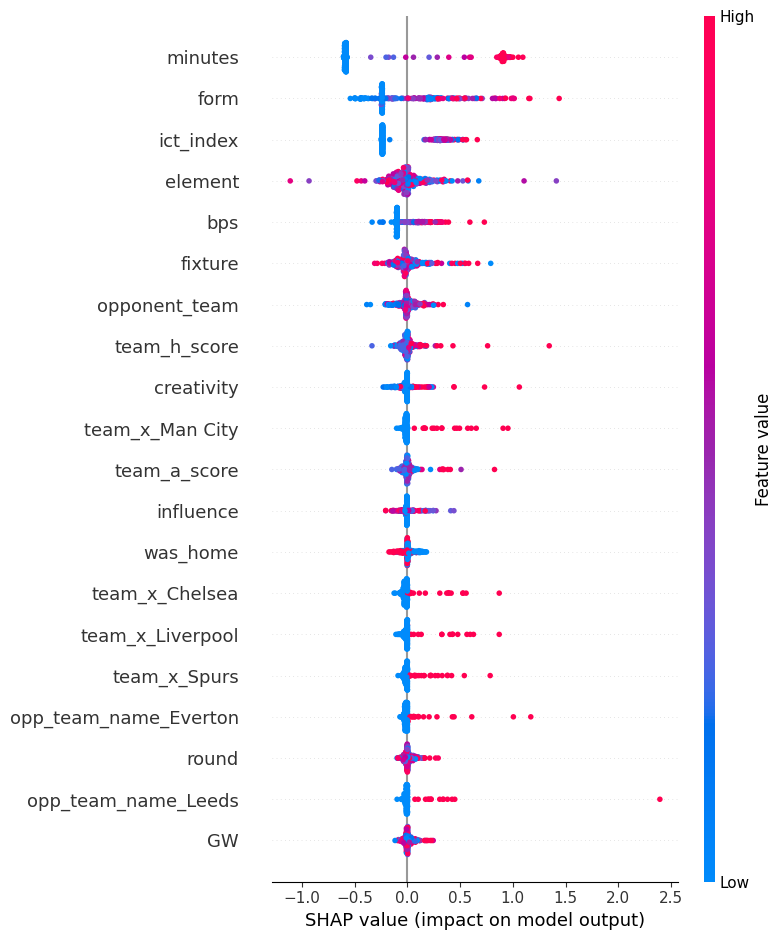

In [58]:
sample = X_test.sample(300, random_state=42)
explainer = shap.TreeExplainer(def_statistical_model)
shap_values = explainer.shap_values(sample, approximate=True)
shap.summary_plot(shap_values, sample)

### **LIME**

In [59]:
features = X_train.columns.tolist()

explainer = LimeTabularExplainer(
    X_train.values,
    feature_names=features,
    mode="regression"
)

def predict_fn(x):
    # Convert NumPy array back to DataFrame with proper column names
    return def_statistical_model.predict(pd.DataFrame(x, columns=features))

i = 5
exp = explainer.explain_instance(
    X_test.iloc[i].values,
    predict_fn,   # Use the wrapped prediction function
    num_samples=1000
)
exp.show_in_notebook()

## **Train NN Model**

In [60]:
# Scale the data (important for neural networks)
scaler_def = StandardScaler()
X_train_scaled = scaler_def.fit_transform(X_train)
X_test_scaled = scaler_def.transform(X_test)

In [61]:
def_nn_model = Sequential([
    Dense(256, input_shape=(X_train_scaled.shape[1],)),
    LeakyReLU(alpha=0.1),
    BatchNormalization(),
    Dropout(0.3),
    Dense(128, activation='relu'),
    LeakyReLU(alpha=0.1),
    BatchNormalization(),
    Dropout(0.2),
    Dense(64, activation='relu'),
    Dense(1)
])

# Compile
def_nn_model.compile(
    # optimizer=Adam(learning_rate=0.001),
    optimizer=Adam(learning_rate=0.0005),
    loss='mean_squared_error',
    metrics=['mae']
)

def_nn_model.summary()

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.12/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_8 (Dense)                 │ (None, 256)            │        23,552 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_4 (LeakyReLU)       │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 256)            │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_4 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_5 (LeakyReLU)       │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 128)            │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_5 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_10 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_11 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 66,305 (259.00 KB)

 Trainable params: 65,537 (256.00 KB)

 Non-trainable params: 768 (3.00 KB)

In [62]:
history = def_nn_model.fit(
    X_train_scaled, y_train,
    validation_data=(X_test_scaled, y_test),
    epochs=200,
    batch_size=64,
    callbacks=[early_stop, lr_scheduler],
    verbose=1
)

Epoch 1/200
410/410 ━━━━━━━━━━━━━━━━━━━━ 7s 9ms/step - loss: 6.1499 - mae: 1.5709 - val_loss: 5.0694 - val_mae: 1.4526 - learning_rate: 5.0000e-04
Epoch 2/200
410/410 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.0304 - mae: 1.4324 - val_loss: 5.0225 - val_mae: 1.3644 - learning_rate: 5.0000e-04
Epoch 3/200
410/410 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.8302 - mae: 1.3815 - val_loss: 4.9650 - val_mae: 1.3734 - learning_rate: 5.0000e-04
Epoch 4/200
410/410 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4.6540 - mae: 1.3585 - val_loss: 4.9643 - val_mae: 1.3243 - learning_rate: 5.0000e-04
Epoch 5/200
410/410 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 4.6218 - mae: 1.3377 - val_loss: 4.9330 - val_mae: 1.3566 - learning_rate: 5.0000e-04
Epoch 6/200
410/410 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.5152 - mae: 1.3288 - val_loss: 4.9099 - val_mae: 1.3226 - learning_rate: 5.0000e-04
Epoch 7/200
410/410 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.5819 - mae: 1.3379 - val_loss: 4.9324 - val_mae: 1.3156

In [63]:
y_pred = def_nn_model.predict(X_test_scaled).flatten()

# Metrics
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

print(f"MAE: {mae:.3f}")
print(f"MSE: {mse:.3f}")
print(f"RMSE: {rmse:.3f}")
print(f"R²: {r2:.3f}")

205/205 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
MAE: 1.267
MSE: 4.814
RMSE: 2.194
R²: 0.239


### **SHAP**

PermutationExplainer explainer: 6547it [05:39, 18.72it/s]                          
/tmp/ipython-input-1703821631.py:18: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  shap.summary_plot(shap_values.values, X_test,


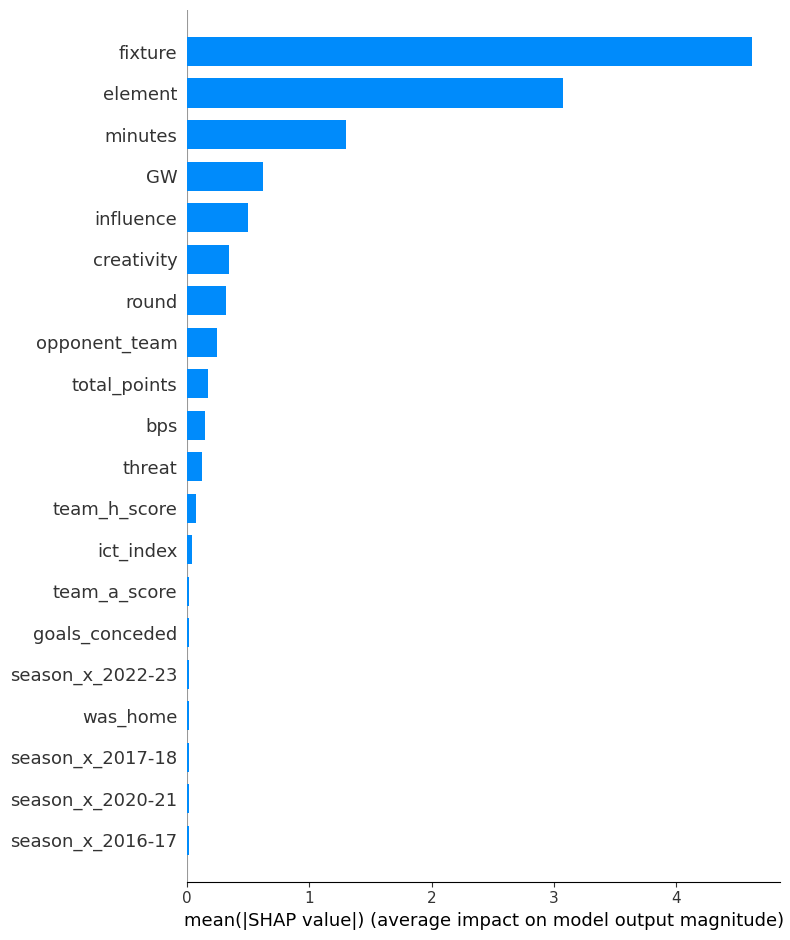

In [64]:
# If you have stored feature names earlier (e.g., from X_train)
feature_names = X.columns.tolist()

# Convert X_test (NumPy) to DataFrame
X_test = pd.DataFrame(X_test, columns=feature_names)

# Wrap your model prediction function
def predict_fn(X):
    return def_nn_model.predict(X)
# Use Explainer -> finds the best XAI model to use for your model
# Use a small background (reference) set to speed up explanations
# If X_train_scaled is a DataFrame, shap.sample will preserve columns
background = shap.sample(X_train, 100, random_state=42)
# Let SHAP pick the best algorithm for your Keras model
explainer = shap.Explainer(def_nn_model, background)
shap_values = explainer(X_test)
# Global summary
shap.summary_plot(shap_values.values, X_test,
feature_names=X_test.columns, plot_type='bar')
# Local explanation
i = 0
# Easiest way with the new API
shap.initjs()
shap.plots.force(shap_values[i])

### **LIME**

In [65]:
# Convert X_train_scaled back to a DataFrame with feature names
X_train_df = pd.DataFrame(X_train_scaled, columns=feature_names)
X_test_df = pd.DataFrame(X_test_scaled, columns=feature_names)

# Define a simple predict function for regression
def predict_fn(x):
    return def_nn_model.predict(x).flatten()

# Create LIME explainer for regression
explainer_lime = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train_df.values,
    feature_names=feature_names,
    mode='regression',                # 👈 important: regression mode
    discretize_continuous=True
)

# Pick one sample to explain
i = 0
exp = explainer_lime.explain_instance(
    data_row=X_test_df.values[i],
    predict_fn=predict_fn,
    num_features=6
)

# Show explanation
exp.show_in_notebook()

157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


# **FWD POSITION MODELS**

## **Choose Features**

In [66]:
forwards_df = df[df['position_FWD'] == 1]

X = forwards_df.drop([
    'upcoming_total_points',
    'saves',
    'penalties_saved',
    'clean_sheets',
    'position_DEF',
    'position_FWD',
    'position_GK',
    'position_MID'
], axis=1)

y = forwards_df['upcoming_total_points']


## **Train Statistical Model**

In [67]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

fwd_statistical_model = RandomForestRegressor(n_estimators=500, random_state=42)
fwd_statistical_model.fit(X_train, y_train)

y_pred = fwd_statistical_model.predict(X_test)

mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

print(f"MAE: {mae:.3f}")
print(f"MSE: {mse:.3f}")
print(f"RMSE: {rmse:.3f}")
print(f"R²: {r2:.3f}")

MAE: 1.452
MSE: 6.334
RMSE: 2.517
R²: 0.259


### **SHAP**

/tmp/ipython-input-3059856683.py:4: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  shap.summary_plot(shap_values, sample)


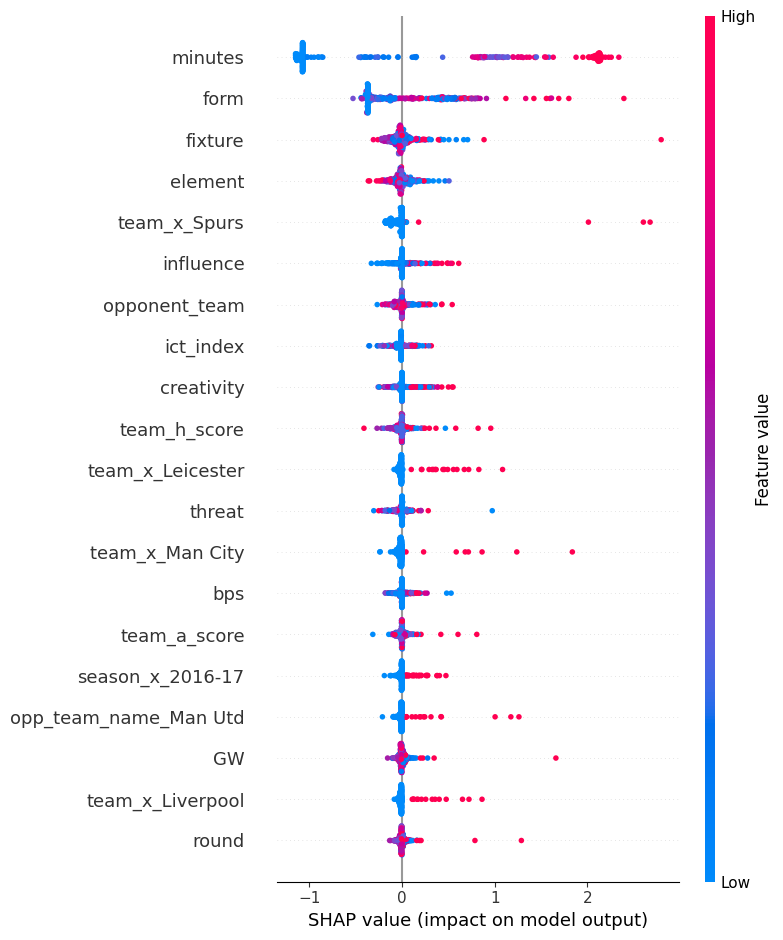

In [68]:
sample = X_test.sample(300, random_state=42)
explainer = shap.TreeExplainer(fwd_statistical_model)
shap_values = explainer.shap_values(sample, approximate=True)
shap.summary_plot(shap_values, sample)

### **LIME**

In [69]:
features = X_train.columns.tolist()

explainer = LimeTabularExplainer(
    X_train.values,
    feature_names=features,
    mode="regression"
)

def predict_fn(x):
    # Convert NumPy array back to DataFrame with proper column names
    return fwd_statistical_model.predict(pd.DataFrame(x, columns=features))

i = 5
exp = explainer.explain_instance(
    X_test.iloc[i].values,
    predict_fn,   # Use the wrapped prediction function
    num_samples=1000
)
exp.show_in_notebook()

## **Train NN Model**

In [70]:
# Scale the data (important for neural networks)
scaler_fwd = StandardScaler()
X_train_scaled = scaler_fwd.fit_transform(X_train)
X_test_scaled = scaler_fwd.transform(X_test)

In [71]:
fwd_nn_model = Sequential([
    Dense(256, input_shape=(X_train_scaled.shape[1],)),
    LeakyReLU(alpha=0.1),
    BatchNormalization(),
    Dropout(0.3),
    Dense(128, activation='relu'),
    LeakyReLU(alpha=0.1),
    BatchNormalization(),
    Dropout(0.2),
    Dense(64, activation='relu'),
    Dense(1)
])

# Compile
fwd_nn_model.compile(
    # optimizer=Adam(learning_rate=0.001),
    optimizer=Adam(learning_rate=0.0005),
    loss='mean_squared_error',
    metrics=['mae']
)

fwd_nn_model.summary()

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.12/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_12 (Dense)                │ (None, 256)            │        23,552 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_6 (LeakyReLU)       │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 256)            │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_6 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_13 (Dense)                │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_7 (LeakyReLU)       │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_7           │ (None, 128)            │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_7 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_14 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_15 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 66,305 (259.00 KB)

 Trainable params: 65,537 (256.00 KB)

 Non-trainable params: 768 (3.00 KB)

In [72]:
history = fwd_nn_model.fit(
    X_train_scaled, y_train,
    validation_data=(X_test_scaled, y_test),
    epochs=200,
    batch_size=64,
    callbacks=[early_stop, lr_scheduler],
    verbose=1
)

Epoch 1/200
154/154 ━━━━━━━━━━━━━━━━━━━━ 7s 20ms/step - loss: 7.1305 - mae: 1.6131 - val_loss: 7.0391 - val_mae: 1.3491 - learning_rate: 5.0000e-04
Epoch 2/200
154/154 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.8154 - mae: 1.5875 - val_loss: 6.5731 - val_mae: 1.3966 - learning_rate: 5.0000e-04
Epoch 3/200
154/154 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.7652 - mae: 1.4709 - val_loss: 6.3881 - val_mae: 1.4326 - learning_rate: 5.0000e-04
Epoch 4/200
154/154 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.6489 - mae: 1.4618 - val_loss: 6.3315 - val_mae: 1.4275 - learning_rate: 5.0000e-04
Epoch 5/200
154/154 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.4291 - mae: 1.4002 - val_loss: 6.3093 - val_mae: 1.4398 - learning_rate: 5.0000e-04
Epoch 6/200
154/154 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.6721 - mae: 1.4346 - val_loss: 6.3142 - val_mae: 1.4515 - learning_rate: 5.0000e-04
Epoch 7/200
154/154 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.4090 - mae: 1.4235 - val_loss: 6.4173 - val_mae: 1.450

In [73]:
y_pred = fwd_nn_model.predict(X_test_scaled).flatten()

# Metrics
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

print(f"MAE: {mae:.3f}")
print(f"MSE: {mse:.3f}")
print(f"RMSE: {rmse:.3f}")
print(f"R²: {r2:.3f}")

77/77 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step
MAE: 1.440
MSE: 6.309
RMSE: 2.512
R²: 0.262


### **SHAP**

PermutationExplainer explainer: 2461it [02:13, 16.98it/s]                          
/tmp/ipython-input-2556123841.py:18: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  shap.summary_plot(shap_values.values, X_test,


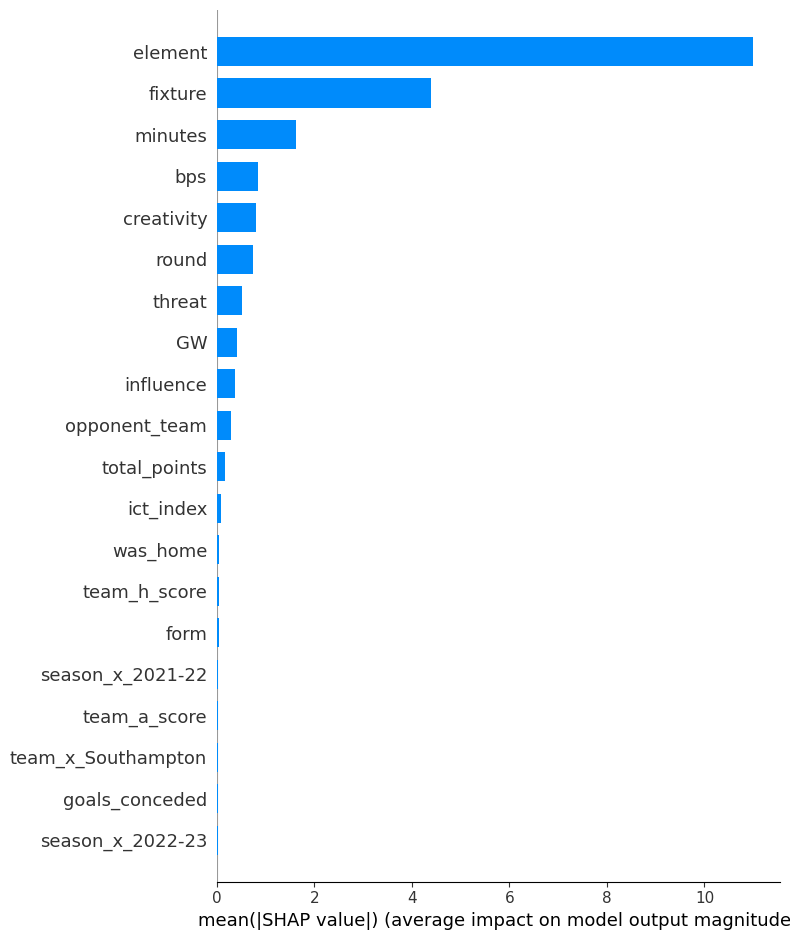

In [74]:
# If you have stored feature names earlier (e.g., from X_train)
feature_names = X.columns.tolist()

# Convert X_test (NumPy) to DataFrame
X_test = pd.DataFrame(X_test, columns=feature_names)

# Wrap your model prediction function
def predict_fn(X):
    return fwd_nn_model.predict(X)
# Use Explainer -> finds the best XAI model to use for your model
# Use a small background (reference) set to speed up explanations
# If X_train_scaled is a DataFrame, shap.sample will preserve columns
background = shap.sample(X_train, 100, random_state=42)
# Let SHAP pick the best algorithm for your Keras model
explainer = shap.Explainer(fwd_nn_model, background)
shap_values = explainer(X_test)
# Global summary
shap.summary_plot(shap_values.values, X_test,
feature_names=X_test.columns, plot_type='bar')
# Local explanation
i = 0
# Easiest way with the new API
shap.initjs()
shap.plots.force(shap_values[i])

### **LIME**

In [75]:
# Convert X_train_scaled back to a DataFrame with feature names
X_train_df = pd.DataFrame(X_train_scaled, columns=feature_names)
X_test_df = pd.DataFrame(X_test_scaled, columns=feature_names)

# Define a simple predict function for regression
def predict_fn(x):
    return fwd_nn_model.predict(x).flatten()

# Create LIME explainer for regression
explainer_lime = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train_df.values,
    feature_names=feature_names,
    mode='regression',                # 👈 important: regression mode
    discretize_continuous=True
)

# Pick one sample to explain
i = 0
exp = explainer_lime.explain_instance(
    data_row=X_test_df.values[i],
    predict_fn=predict_fn,
    num_features=6
)

# Show explanation
exp.show_in_notebook()


157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


# **GK POSITION MODELS**

## **Choose Features**

In [76]:
gk_df = df[df["position_GK"] == 1]

X = gk_df.drop([
    "upcoming_total_points",
    "position_DEF",
    "position_FWD",
    "position_GK",
    "position_MID",
    "creativity",
    "ict_index",
    "influence",
    "threat"
], axis=1)

y = gk_df["upcoming_total_points"]


## **Train Statistical Model**

In [77]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

gk_statistical_model = RandomForestRegressor(n_estimators=500, random_state=42)
gk_statistical_model.fit(X_train, y_train)

y_pred = gk_statistical_model.predict(X_test)

mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

print(f"MAE: {mae:.3f}")
print(f"MSE: {mse:.3f}")
print(f"RMSE: {rmse:.3f}")
print(f"R²: {r2:.3f}")

MAE: 0.939
MSE: 3.529
RMSE: 1.879
R²: 0.366


### **SHAP**

/tmp/ipython-input-3065394798.py:4: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  shap.summary_plot(shap_values, sample)


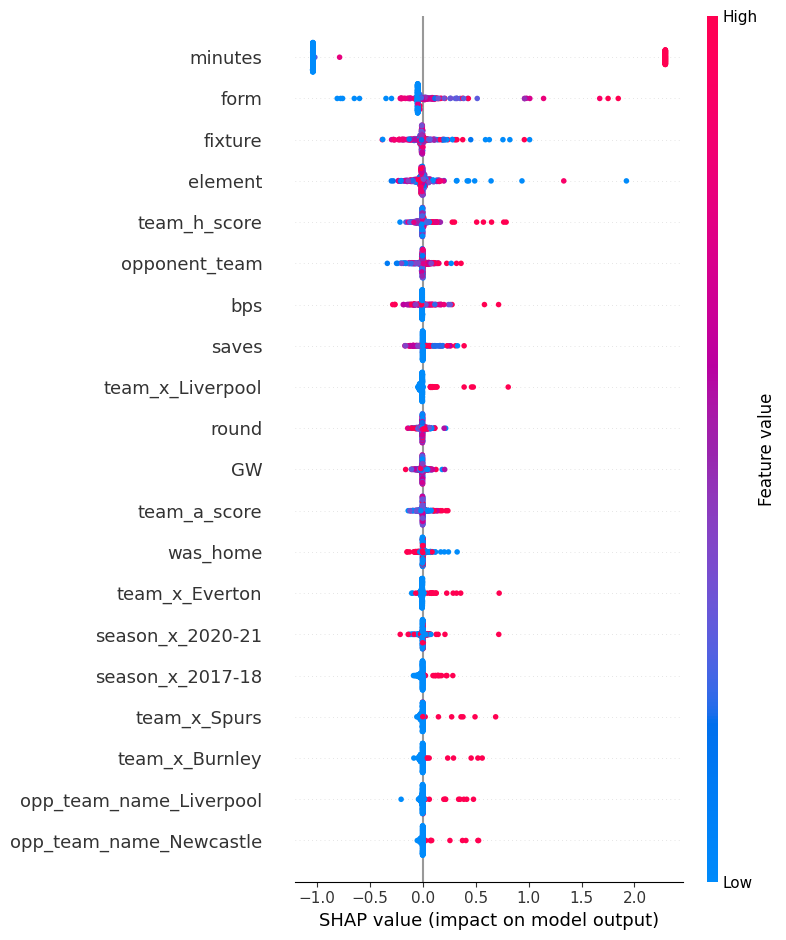

In [78]:
sample = X_test.sample(300, random_state=42)
explainer = shap.TreeExplainer(gk_statistical_model)
shap_values = explainer.shap_values(sample, approximate=True)
shap.summary_plot(shap_values, sample)

### **LIME**

In [79]:
features = X_train.columns.tolist()

explainer = LimeTabularExplainer(
    X_train.values,
    feature_names=features,
    mode="regression"
)

def predict_fn(x):
    # Convert NumPy array back to DataFrame with proper column names
    return gk_statistical_model.predict(pd.DataFrame(x, columns=features))

i = 5
exp = explainer.explain_instance(
    X_test.iloc[i].values,
    predict_fn,   # Use the wrapped prediction function
    num_samples=1000
)
exp.show_in_notebook()

## **Train NN Model**

In [80]:
# Scale the data (important for neural networks)
scaler_gk = StandardScaler()
X_train_scaled = scaler_gk.fit_transform(X_train)
X_test_scaled = scaler_gk.transform(X_test)

In [81]:
gk_nn_model = Sequential([
    Dense(256, input_shape=(X_train_scaled.shape[1],)),
    LeakyReLU(alpha=0.1),
    BatchNormalization(),
    Dropout(0.3),
    Dense(128, activation='relu'),
    LeakyReLU(alpha=0.1),
    BatchNormalization(),
    Dropout(0.2),
    Dense(64, activation='relu'),
    Dense(1)
])

# Compile
gk_nn_model.compile(
    # optimizer=Adam(learning_rate=0.001),
    optimizer=Adam(learning_rate=0.0005),
    loss='mean_squared_error',
    metrics=['mae']
)

gk_nn_model.summary()

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.12/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_16 (Dense)                │ (None, 256)            │        23,296 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_8 (LeakyReLU)       │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_8           │ (None, 256)            │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_8 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_17 (Dense)                │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_9 (LeakyReLU)       │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_9           │ (None, 128)            │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_9 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_18 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_19 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 66,049 (258.00 KB)

 Trainable params: 65,281 (255.00 KB)

 Non-trainable params: 768 (3.00 KB)

In [82]:
history = gk_nn_model.fit(
    X_train_scaled, y_train,
    validation_data=(X_test_scaled, y_test),
    epochs=200,
    batch_size=64,
    callbacks=[early_stop, lr_scheduler],
    verbose=1
)

Epoch 1/200
130/130 ━━━━━━━━━━━━━━━━━━━━ 7s 21ms/step - loss: 5.7893 - mae: 1.4758 - val_loss: 3.8461 - val_mae: 0.9572 - learning_rate: 5.0000e-04
Epoch 2/200
130/130 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.9103 - mae: 1.2199 - val_loss: 3.5691 - val_mae: 1.0082 - learning_rate: 5.0000e-04
Epoch 3/200
130/130 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.3261 - mae: 1.1004 - val_loss: 3.5955 - val_mae: 1.0451 - learning_rate: 5.0000e-04
Epoch 4/200
130/130 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.4018 - mae: 1.1179 - val_loss: 3.5782 - val_mae: 1.0157 - learning_rate: 5.0000e-04
Epoch 5/200
130/130 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.1257 - mae: 1.0456 - val_loss: 3.5304 - val_mae: 1.0079 - learning_rate: 5.0000e-04
Epoch 6/200
130/130 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 3.4221 - mae: 1.0985 - val_loss: 3.5945 - val_mae: 0.9709 - learning_rate: 5.0000e-04
Epoch 7/200
130/130 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 3.0016 - mae: 0.9923 - val_loss: 3.6142 - val_mae: 1.002

In [83]:
y_pred = gk_nn_model.predict(X_test_scaled).flatten()

# Metrics
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

print(f"MAE: {mae:.3f}")
print(f"MSE: {mse:.3f}")
print(f"RMSE: {rmse:.3f}")
print(f"R²: {r2:.3f}")

65/65 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
MAE: 1.008
MSE: 3.530
RMSE: 1.879
R²: 0.365


### **SHAP**

PermutationExplainer explainer: 2070it [01:47, 17.52it/s]
/tmp/ipython-input-1914543604.py:18: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  shap.summary_plot(shap_values.values, X_test,


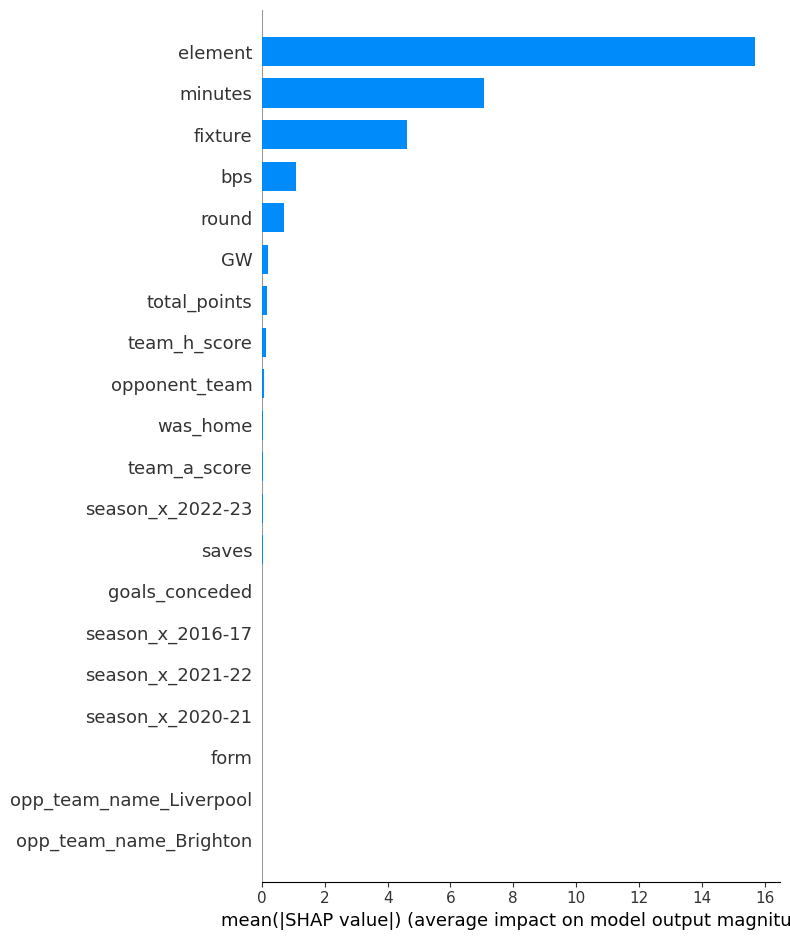

In [84]:
# If you have stored feature names earlier (e.g., from X_train)
feature_names = X.columns.tolist()

# Convert X_test (NumPy) to DataFrame
X_test = pd.DataFrame(X_test, columns=feature_names)

# Wrap your model prediction function
def predict_fn(X):
    return gk_nn_model.predict(X)
# Use Explainer -> finds the best XAI model to use for your model
# Use a small background (reference) set to speed up explanations
# If X_train_scaled is a DataFrame, shap.sample will preserve columns
background = shap.sample(X_train, 100, random_state=42)
# Let SHAP pick the best algorithm for your Keras model
explainer = shap.Explainer(gk_nn_model, background)
shap_values = explainer(X_test)
# Global summary
shap.summary_plot(shap_values.values, X_test,
feature_names=X_test.columns, plot_type='bar')
# Local explanation
i = 0
# Easiest way with the new API
shap.initjs()
shap.plots.force(shap_values[i])

### **LIME**

In [85]:
# Convert X_train_scaled back to a DataFrame with feature names
X_train_df = pd.DataFrame(X_train_scaled, columns=feature_names)
X_test_df = pd.DataFrame(X_test_scaled, columns=feature_names)

# Define a simple predict function for regression
def predict_fn(x):
    return gk_nn_model.predict(x).flatten()

# Create LIME explainer for regression
explainer_lime = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train_df.values,
    feature_names=feature_names,
    mode='regression',                # 👈 important: regression mode
    discretize_continuous=True
)

# Pick one sample to explain
i = 0
exp = explainer_lime.explain_instance(
    data_row=X_test_df.values[i],
    predict_fn=predict_fn,
    num_features=6
)

# Show explanation
exp.show_in_notebook()

157/157 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


# **Inference Function**

In [86]:
def predict_upcoming_points(input_dict):
    # Convert input into DataFrame
    input_df = pd.DataFrame([input_dict])
    position = input_dict.get("position", "").upper()

    # ==== Define feature lists used during training ====
    general_features = [col for col in df.columns if col not in [
        'upcoming_total_points'
    ]]

    mid_features = [col for col in df.columns if col not in [
        'upcoming_total_points', 'clean_sheets',
        'position_MID', 'position_GK', 'position_FWD', 'position_DEF',
        'penalties_saved', 'saves'
    ]]

    def_features = [col for col in df.columns if col not in [
        'upcoming_total_points', 'saves', 'penalties_saved', 'clean_sheets',
        'position_DEF', 'position_FWD', 'position_GK', 'position_MID'
    ]]

    fwd_features = [col for col in df.columns if col not in [
        'upcoming_total_points', 'saves', 'penalties_saved', 'clean_sheets',
        'position_DEF', 'position_FWD', 'position_GK', 'position_MID'
    ]]

    gk_features = [col for col in df.columns if col not in [
        'upcoming_total_points', 'position_DEF', 'position_FWD', 'position_GK',
        'position_MID', 'creativity', 'ict_index', 'influence', 'threat'
    ]]

    # ==== Select correct model and features ====
    if position == "MID":
        model_to_use = mid_nn_model ## or general_nn_model or mid_nn_model or mid_statistical_model
        features_to_use =  mid_features ## or mid_features
        scaler_to_use = scaler_mid ## or scaler_mid
    elif position == "DEF":
        model_to_use = general_nn_model ## or def_nn_model or general_nn_model or general_statistical_model
        features_to_use = general_nn_model ## or general_features
        scaler_to_use = scaler_general ## or scaler_general
    elif position == "FWD":
        model_to_use = general_nn_model ## or fwd_statistical_model or general_nn_model or general_statistical_model
        features_to_use = general_features ## or general_features
        scaler_to_use = scaler_general ## or scaler_general
    elif position == "GK":
        model_to_use = gk_statistical_model ## or gk_statistical_model or general_nn_model or general_statistical_model
        features_to_use = gk_features ## or general_features
        scaler_to_use = scaler_gk ## or scaler_general
    else:
        # Fallback to general model if unknown
        model_to_use = general_nn_model
        features_to_use = general_features
        scaler_to_use = scaler_general

    # ==== Match input to training features ====
    input_df = input_df.reindex(columns=features_to_use, fill_value=0)

    # ==== Apply scaling ====
    input_scaled = scaler_to_use.transform(input_df)

    # ==== Make prediction ====
    prediction = model_to_use.predict(input_scaled)[0]

    # ==== Format in natural language ====
    if prediction < 1:
        feedback = "The player is expected to score very few points next gameweek."
    elif prediction < 3:
        feedback = "The player is expected to have an average performance."
    elif prediction < 6:
        feedback = "The player is likely to perform well and gain several points."
    else:
        feedback = "The player is expected to deliver an excellent performance!"

    # Round for display
    prediction = round(float(prediction), 2)

    return f"Predicted upcoming total points: {prediction}. {feedback}"

In [87]:
df.to_csv('cleaned_data.csv', index=False)

In [88]:
from google.colab import files
files.download('cleaned_data.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>